In [204]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from PIL import Image
import sys
from math import log10, sqrt

# Konvertiranje v JPEG

In [218]:

splash = Image.open("standard-test-images/splash.tiff")
splash_numpy = np.array(splash)
rgb_splash = splash.convert('RGB')

mandril = Image.open("standard-test-images/mandril.tiff")
mandril_numpy = np.array(mandril)
rgb_mandril = mandril.convert('RGB')

peppers = Image.open('standard-test-images/peppers.tiff')
peppers_numpy = np.array(peppers)
rgb_peppers = peppers.convert('RGB')

text = Image.open('standard-test-images/jpeg.png').convert('L')
text_numpy = np.array(text)
rgb_text = text.convert('RGB')

# Display the image

# Set JPEG quality levels
qualities = [5, 25, 50, 75, 95]

#Save the images with different qualities
for q in qualities:
    path1 = f'JPEG/splash_Q{q}.jpeg'
    rgb_splash.save(path1, quality=q)
    print(f"Image saved successfully: {path1}")

    path2 = f'JPEG/mandril_Q{q}.jpeg'
    rgb_mandril.save(path2, quality=q)
    print(f"Image saved successfully: {path2}")

    path3 = f'JPEG/peppers_Q{q}.jpeg'
    rgb_peppers.save(path3, quality=q)
    print(f"Image saved successfully: {path3}")

    path4 = f'JPEG/text_Q{q}.jpeg'
    rgb_text.save(path4, quality=q)
    print(f"Image saved successfully: {path4}")

Image saved successfully: JPEG/splash_Q5.jpeg
Image saved successfully: JPEG/mandril_Q5.jpeg
Image saved successfully: JPEG/peppers_Q5.jpeg
Image saved successfully: JPEG/text_Q5.jpeg
Image saved successfully: JPEG/splash_Q25.jpeg
Image saved successfully: JPEG/mandril_Q25.jpeg
Image saved successfully: JPEG/peppers_Q25.jpeg
Image saved successfully: JPEG/text_Q25.jpeg
Image saved successfully: JPEG/splash_Q50.jpeg
Image saved successfully: JPEG/mandril_Q50.jpeg
Image saved successfully: JPEG/peppers_Q50.jpeg
Image saved successfully: JPEG/text_Q50.jpeg
Image saved successfully: JPEG/splash_Q75.jpeg
Image saved successfully: JPEG/mandril_Q75.jpeg
Image saved successfully: JPEG/peppers_Q75.jpeg
Image saved successfully: JPEG/text_Q75.jpeg
Image saved successfully: JPEG/splash_Q95.jpeg
Image saved successfully: JPEG/mandril_Q95.jpeg
Image saved successfully: JPEG/peppers_Q95.jpeg
Image saved successfully: JPEG/text_Q95.jpeg


In [206]:
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [216]:
# Initialize lists to store images and PSNR values
splash_images = []
mandril_images = []
peppers_images = []
text_images = []

psnr_splash = np.zeros(5)
psnr_mandril = np.zeros(5)
psnr_peppers = np.zeros(5)
psnr_text = np.zeros(5)

# Load saved images and calculate PSNR
for i, q in enumerate(qualities):
    splash_images.append(cv2.cvtColor(cv2.imread(f'JPEG/splash_Q{q}.jpeg'), cv2.COLOR_BGR2RGB))
    mandril_images.append(cv2.cvtColor(cv2.imread(f'JPEG/mandril_Q{q}.jpeg'), cv2.COLOR_BGR2RGB))
    peppers_images.append(cv2.cvtColor(cv2.imread(f'JPEG/peppers_Q{q}.jpeg'), cv2.COLOR_BGR2RGB))
    text_images.append(cv2.cvtColor(cv2.imread(f'JPEG/text_Q{q}.jpeg'), cv2.COLOR_BGR2GRAY))

    psnr_splash[i] = cv2.PSNR(splash_numpy, splash_images[i])
    psnr_mandril[i] = cv2.PSNR(mandril_numpy, mandril_images[i])
    psnr_peppers[i] = cv2.PSNR(peppers_numpy, peppers_images[i])
    psnr_text[i] = cv2.PSNR(text_numpy, text_images[i])
# np.set_printoptions(threshold=sys.maxsize)

# Print PSNR values
print("splash:")
print(np.around(psnr_splash, 2))

print("mandril:")
print(np.around(psnr_mandril, 2))

print("peppers:")
print(np.around(psnr_peppers, 2))

print("text:")
print(np.around(psnr_text, 2))

splash:
[24.77 30.5  31.97 33.23 34.91]
mandril:
[19.9  23.5  24.85 26.21 28.85]
peppers:
[23.14 28.04 29.25 30.29 32.07]
text:
[20.16 25.29 29.69 35.51 49.67]


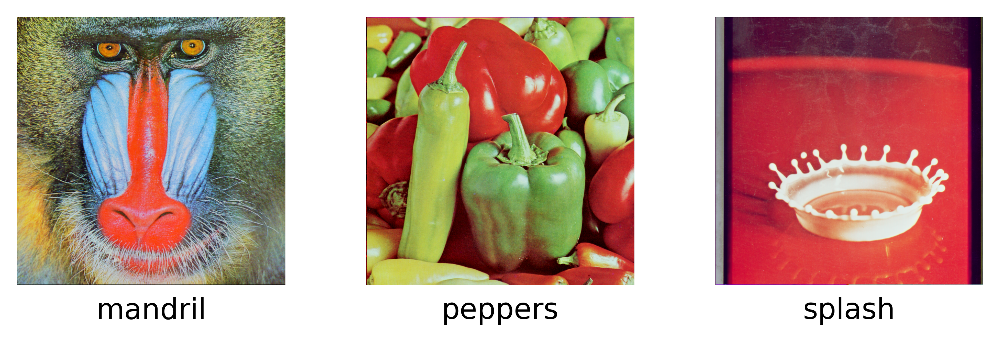

In [208]:
plt.figure(dpi=500)
plt.subplot(1, 3, 1)
plt.tight_layout()
plt.imshow(mandril_numpy)
plt.title("mandril", y=-0.18)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.tight_layout()
plt.imshow(peppers_numpy)
plt.title("peppers", y=-0.18)
plt.axis('off')

plt.subplot(1, 3, 3)
plt.tight_layout()
plt.imshow(splash_numpy)
plt.title("splash", y=-0.18)
plt.axis('off')

plt.savefig('output\Original_mandril_splash_peppers.pdf')
plt.show()


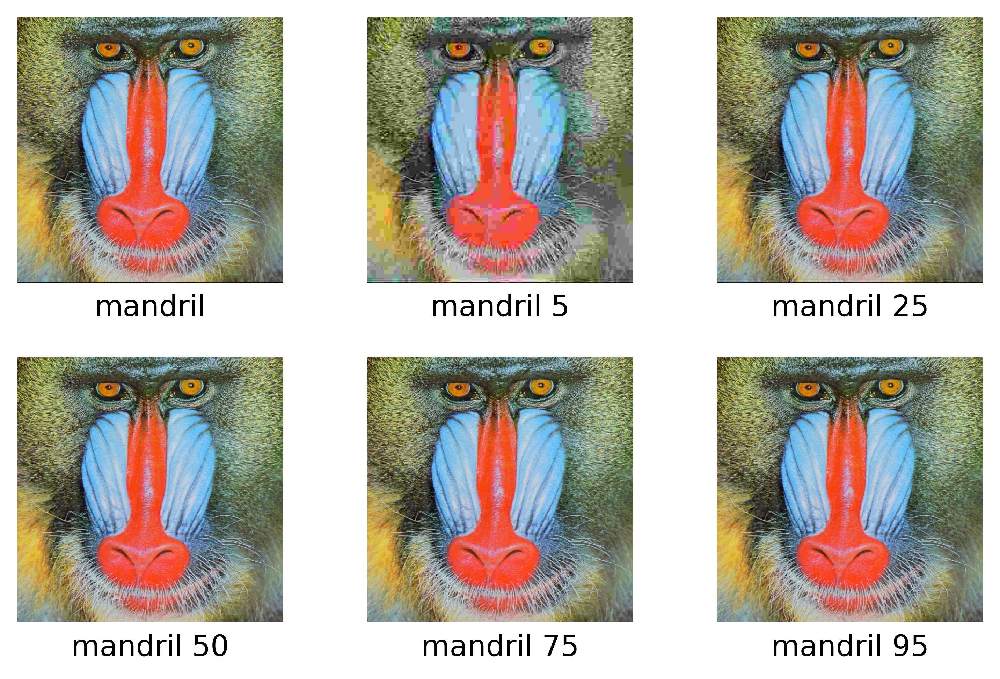

In [209]:
plt.figure(dpi=500)
plt.subplot(2, 3, 1)
plt.tight_layout()
plt.imshow(mandril_numpy)
plt.title("mandril", y=-0.18)
plt.axis('off')

for i in range(5):
    plt.subplot(2, 3, i + 2)
    plt.tight_layout()
    plt.imshow(mandril_images[i])  # Use mandril_images instead of mandril
    plt.title("mandril " + str(qualities[i]), y=-0.18)
    plt.axis('off')

# Use forward slashes in the file path for saving
plt.savefig('output/Quality_mandril.pdf')
plt.show()


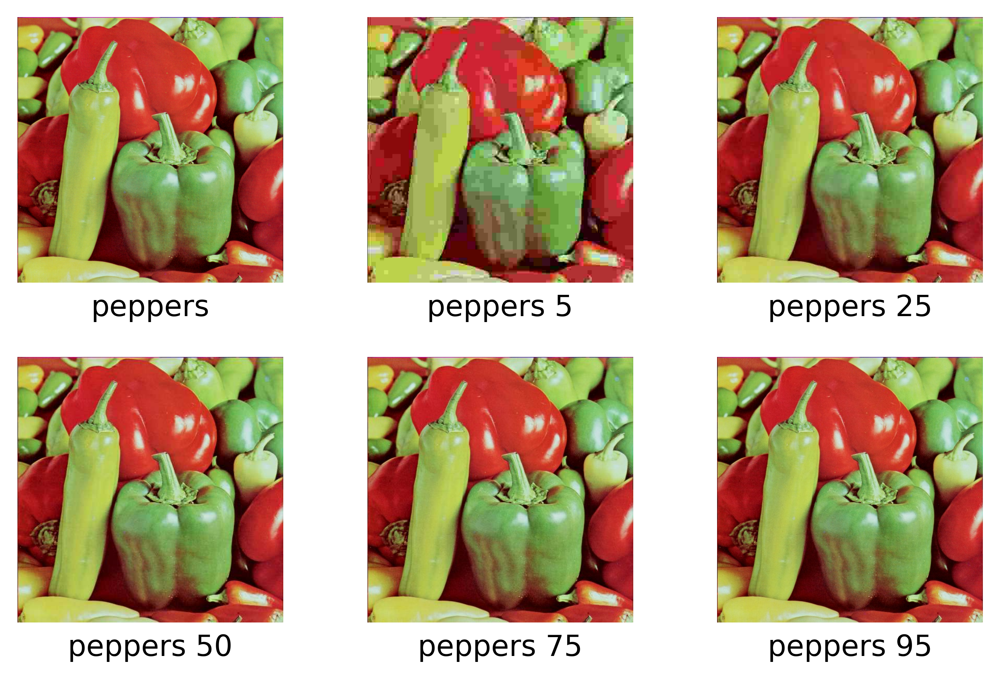

In [210]:
plt.figure(dpi=500)
plt.subplot(2, 3, 1)
plt.tight_layout()
plt.imshow(peppers_numpy)
plt.title("peppers", y=-0.18)
plt.axis('off')

for i in range(5):
    plt.subplot(2, 3, i+2)
    plt.tight_layout()
    plt.imshow(peppers_images[i])
    plt.title("peppers " + str(qualities[i]), y=-0.18)
    plt.axis('off')

plt.savefig('output\Quality_peppers.pdf')
plt.show()


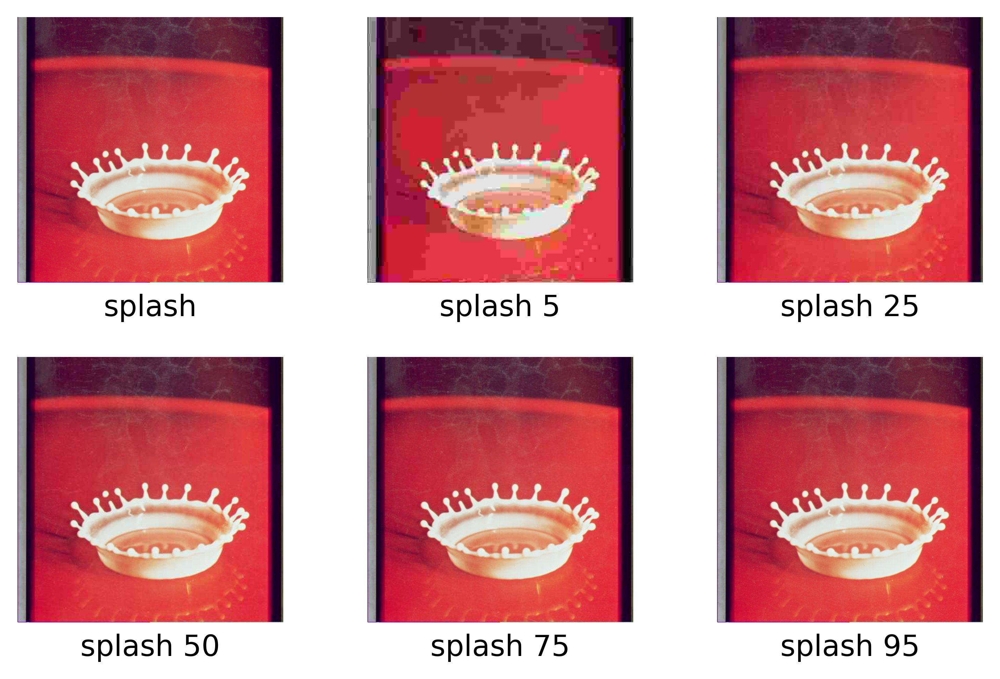

In [211]:
plt.figure(dpi=500)
plt.subplot(2, 3, 1)
plt.tight_layout()
plt.imshow(splash_numpy)
plt.title("splash", y=-0.18)
plt.axis('off')
for i in range(5):
    plt.subplot(2, 3, i+2)
    plt.tight_layout()
    plt.imshow(splash_images[i])
    plt.title("splash " + str(qualities[i]), y=-0.18)
    plt.axis('off')

plt.savefig('output\Quality_splash.pdf')
plt.show()


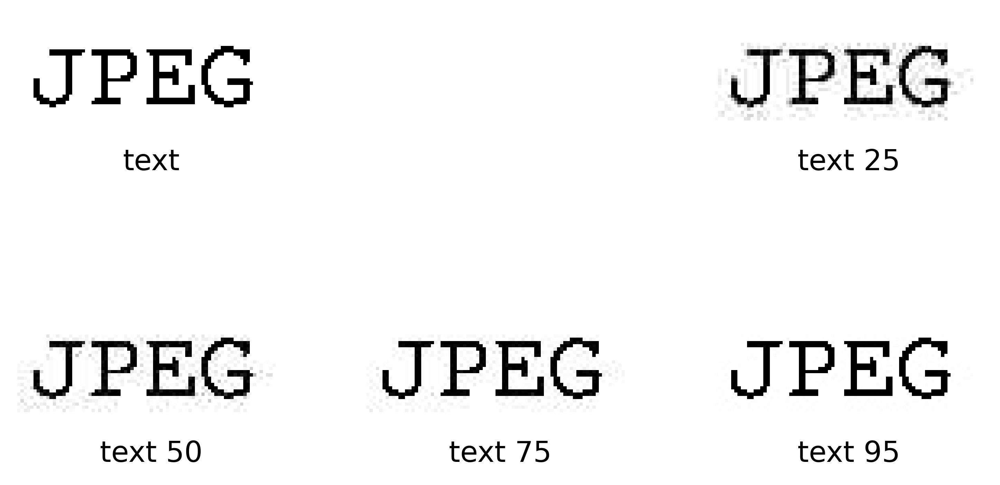

In [213]:
plt.figure(dpi=500)
plt.subplot(2, 3, 1)
plt.tight_layout()
plt.imshow(cv2.cvtColor(cv2.imread(f'standard-test-images/one_jpeg.png'), cv2.COLOR_BGR2GRAY), cmap='gray')  
plt.title("text", y=-0.18)
plt.axis('off')
for i in range(5):
    plt.subplot(2, 3, i+2)
    plt.tight_layout()
    plt.imshow(text_images[i], cmap='gray')
    plt.title("text " + str(qualities[i]), y=-0.18)
    plt.axis('off')
plt.savefig('output/Quality_text_test2.pdf') 
plt.show()

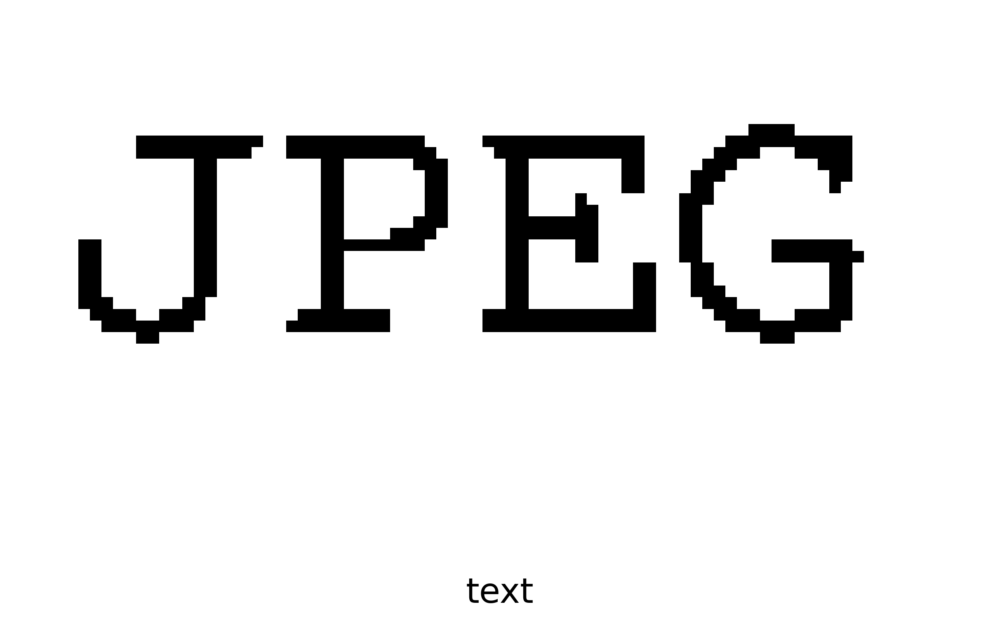

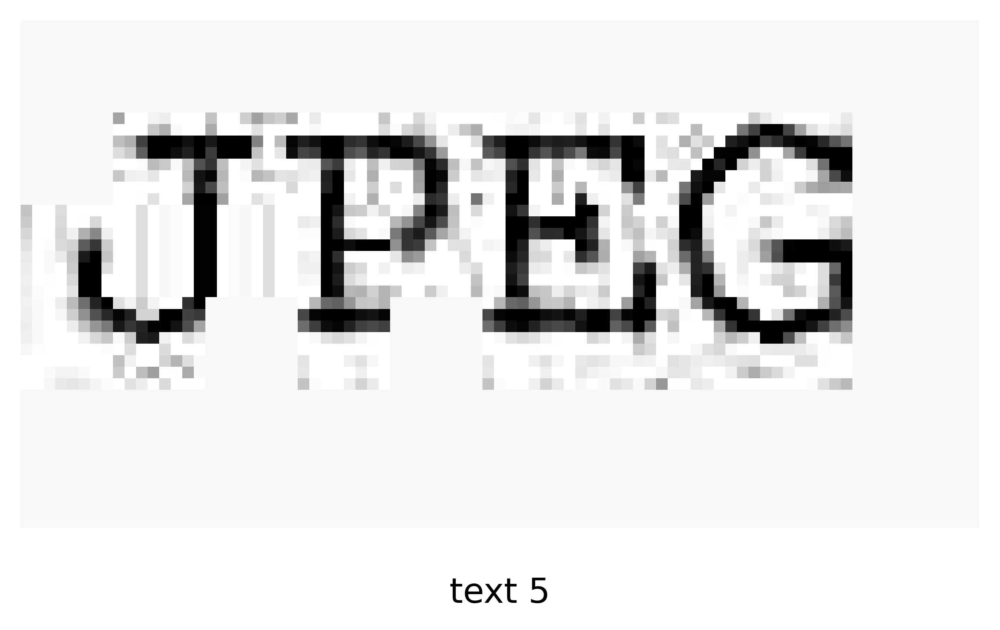

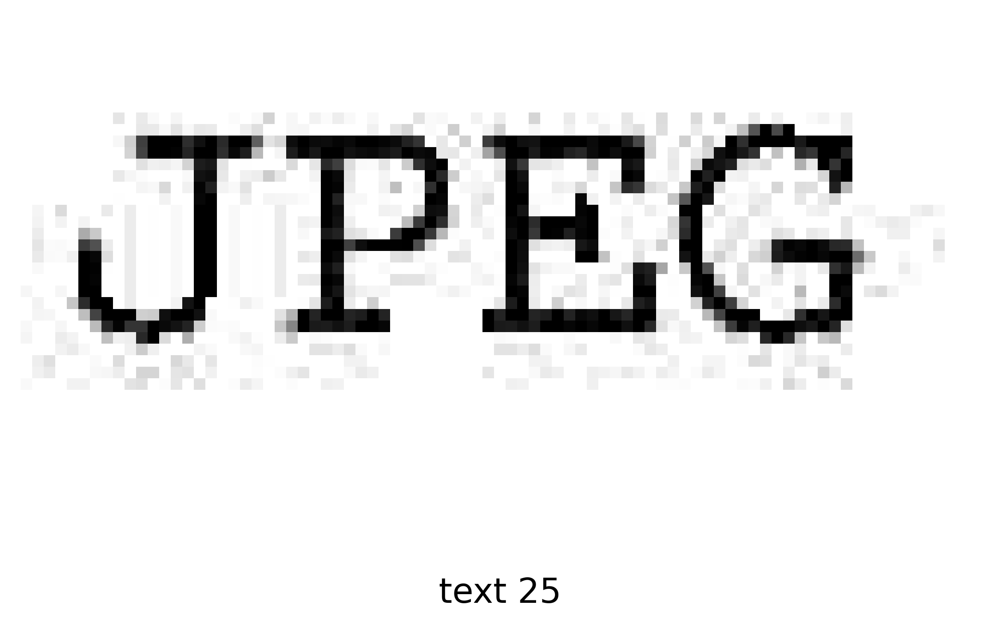

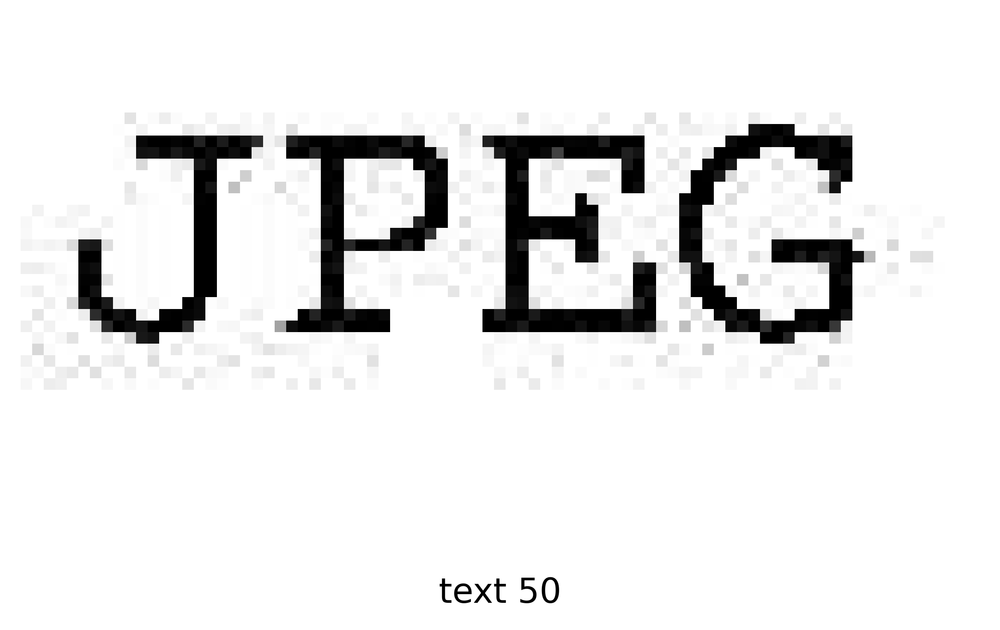

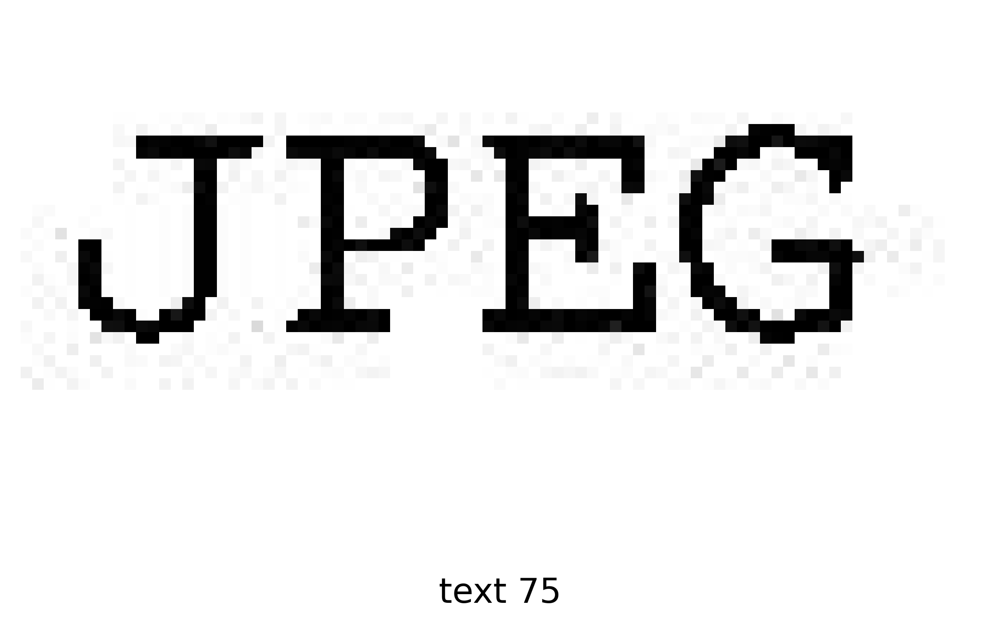

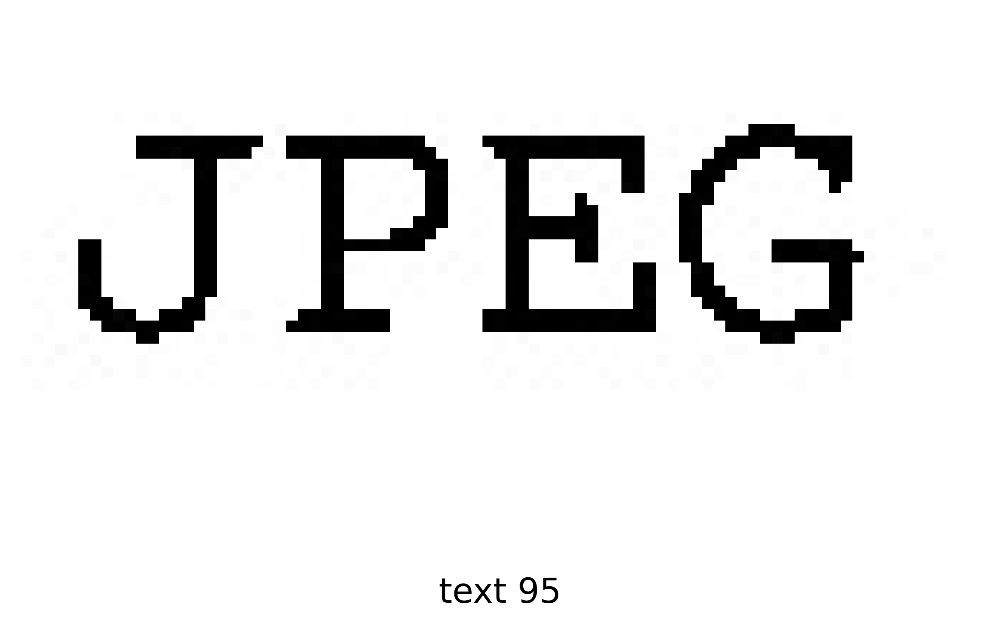

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have 6 grayscale images and corresponding titles
# Replace these with your actual image data and titles
images = [
    text_numpy,
    text_images[0],
    text_images[1],
    text_images[2],
    text_images[3],
    text_images[4]
]

titles = [
    "text",
    "text " + str(qualities[0]),
    "text " + str(qualities[1]),
    "text " + str(qualities[2]),
    "text " + str(qualities[3]),
    "text " + str(qualities[4])
]

for i in range(6):
    plt.figure(dpi=500)
    plt.imshow(images[i], cmap='gray')
    plt.title(titles[i], y=-0.18)
    plt.axis('off')
    plt.show()


In [ ]:
def combine_images(columns, space, images):
    rows = len(images) // columns
    if len(images) % columns:
        rows += 1
    width_max = max([Image.open(image).width for image in images])
    height_max = max([Image.open(image).height for image in images])
    background_width = width_max*columns + (space*columns)-space
    background_height = height_max*rows + (space*rows)-space
    background = Image.new('RGBA', (background_width, background_height), (255, 255, 255, 255))
    x = 0
    y = 0
    for i, image in enumerate(images):
        img = Image.open(image)
        x_offset = int((width_max-img.width)/2)
        y_offset = int((height_max-img.height)/2)
        background.paste(img, (x+x_offset, y+y_offset))
        x += width_max + space
        if (i+1) % columns == 0:
            y += height_max + space
            x = 0
    background.save('image.pdf')


combine_images(columns=3, space=20, images=[f'JPEG/text_Q5.jpeg', f'JPEG/text_Q25.jpeg', f'JPEG/text_Q50.jpeg', f'JPEG/text_Q75.jpeg', f'JPEG/text_Q95.jpeg'])

ValueError: cannot save mode RGBA